<a href="https://colab.research.google.com/github/tinayiluo0322/Explainable-AI-Models-for-Edgy-Scenario-Object-Identification-in-Autonomous-Vehicles/blob/main/XAI_Final_Project_Snow_Car.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# AIPI 590 - XAI | Final Project
### Explainable AI Models for Edgy Scenario Object Identification in Autonomous Vehicles
### Luopeiwen Yi

# Overview

---

## 1. Research Question  
The primary goal of this project is to evaluate the explainability of AI models for object identification in challenging or edge-case scenarios within the context of autonomous driving. Specifically, this research explores how well pre-trained image classification models—**ResNet50** and **VGG16**—perform under conditions like night driving, rain, snow, fog, and broken traffic signs. It also examines how explainability techniques, including **LIME**, **Grad-CAM**, and **Anchor Explanations**, clarify their predictions.  

In this study, 'object identification' refers to the classification of entire images representing scenes or objects, rather than detecting and localizing objects within the image.  

**Hypothesis**: Edge-case scenarios challenge both model performance and explainability, requiring improved methods to handle uncertainty in real-world conditions.

---

## 2. Importance of the Topic  
Autonomous vehicles rely heavily on object identification systems for safe and effective operation. Poor visibility, adverse weather conditions, or damaged infrastructure can cause failures in these systems. As these conditions pose significant safety risks, this project bridges the gap between performance and transparency by improving the explainability of AI models in these challenging scenarios. The findings could inform safer, more reliable AI for autonomous vehicles.

---

## 3. Prior Work in the Field  
While significant advances have been made in Explainable AI (XAI) methods such as LIME and Grad-CAM, most research focuses on ideal conditions. Anchor Explanations have been underexplored in object classification tasks but offer unique insights by identifying specific areas or conditions necessary to maintain a prediction. This project addresses a gap by evaluating models in edge-case scenarios, creating a novel dataset to assess explainability in real-world conditions.

---

## 4. General Approach  

1. **Data Collection**  
   - Collect 8 edge-case images from the internet, depicting scenarios like night driving, snow, fog, rain, and broken cars and road signs.  

2. **Modeling**  
   - Use pre-trained **ResNet50** and **VGG16** for image classification.  

3. **Explainability Evaluation**  
   - Apply **LIME**, **Grad-CAM**, and **Anchor Explanations** to understand why and how the models make decisions.  

4. **Visual Output Analysis**  
   - Visualize and interpret explainability results for edge-case images.  

---

## 5. Data Sources  
- **Custom Dataset**: 8 images sourced online, representing edge-case scenarios (e.g., night driving, snow, fog, etc.).

---

## 6. Unique Contributions  
This project’s uniqueness lies in its:  
1. **Edge-case dataset**: A novel dataset specifically tailored for evaluating object identification in autonomous vehicles.  
2. **Explainability focus**: Assessing widely used XAI methods (LIME, Grad-CAM, Anchor Explanations) in difficult conditions.  
3. **Benchmarking robustness**: Providing insights into model transparency under edge-case scenarios, offering a foundation for future research.  

---

## 7. Final Deliverables  
1. **Slides**: Summarizing the methodology, visual outputs, and insights.  
2. **Video Presentation**: Explaining the project and key findings.  
3. **Colab Notebook**: A documented workflow for reproducibility, including data preprocessing, modeling, and explainability visualizations.


---

### Appendix 1: Summary of XAI Methods for Object Identification  

| **XAI Method**       | **Explanation Mechanism**                                                                 | **Application on Object Identification**                                                                                      | **Visual Output**                                                                                                   |
|-----------------------|-------------------------------------------------------------------------------------------|------------------------------------------------------------------------------------------------------------------------------|---------------------------------------------------------------------------------------------------------------------|
| **LIME**             | Perturbs input data and observes changes in predictions to build local surrogate models.  | Highlights areas in an image (e.g., superpixels) critical to the model's decision.                                           | Overlay of superpixels showing important areas for object classification.                                          |
| **Grad-CAM**         | Uses gradients of the model's output with respect to the final convolutional layer.       | Identifies important pixel regions contributing to the model's classification.                                               | Heatmap superimposed on the original image, with warm colors indicating important regions.                         |
| **Anchor**            | Constructs rules (anchors) that specify conditions sufficient for a prediction.           | Identifies the specific parts of an image or conditions that ensure the model's classification remains consistent.           | Highlighted areas (anchors) showing conditions that strongly influenced the model's decision.                      |

---

### Appendix 2: Explainability Metrics Benchmark Table  

| **Dataset**       | **Model**  | **XAI Technique**      | **Explainability Analysis Case Study** |
|--------------------|------------|------------------------|-----------------------------------------|
| **Edge-Case Data** | ResNet50   | LIME                   | TBD                                     |
| **Edge-Case Data** | ResNet50   | Grad-CAM               | TBD                                     |
| **Edge-Case Data** | ResNet50   | Anchor                 | TBD                                     |
| **Edge-Case Data** | VGG16      | LIME                   | TBD                                     |
| **Edge-Case Data** | VGG16      | Grad-CAM               | TBD                                     |
| **Edge-Case Data** | VGG16      | Anchor                 | TBD                                     |

### Environment Setup and Libraries Import

In [1]:
import os

# Remove Colab default sample_data if it exists
if os.path.isdir("./sample_data"):
    !rm -r ./sample_data

# Clone GitHub repo (force re-clone if it already exists)
repo_name = "XAI_Projects"
git_path = 'https://github.com/tinayiluo0322/XAI_Projects.git'

if os.path.isdir(repo_name):
    !rm -rf "{repo_name}"
!git clone "{git_path}"

# Install dependencies from requirements.txt if it exists
#requirements_file = os.path.join(repo_name, 'requirements.txt')
#if os.path.isfile(requirements_file):
    #!pip install -r "{requirements_file}"
#else:
    #print("No requirements.txt found, skipping dependency installation.")

# Change working directory to location of notebook
notebook_dir = 'Final_Project'
path_to_notebook = os.path.join(repo_name, notebook_dir)

# Check if the directory exists
if os.path.isdir(path_to_notebook):
    %cd "{path_to_notebook}"
    %ls
else:
    print(f"Directory {path_to_notebook} not found")

Cloning into 'XAI_Projects'...
remote: Enumerating objects: 6142, done.
remote: Counting objects: 100% (64/64), done.
remote: Compressing objects: 100% (57/57), done.
remote: Total 6142 (delta 28), reused 6 (delta 6), pack-reused 6078 (from 1)
Receiving objects: 100% (6142/6142), 134.95 MiB | 26.67 MiB/s, done.
Resolving deltas: 100% (51/51), done.
Updating files: 100% (5027/5027), done.
/content/XAI_Projects/Final_Project
placeholder


In [2]:
# Install base dependencies
!pip install numpy pandas matplotlib scikit-learn tensorflow alibi[tensorflow]

# Resolve specific dependency conflicts
!pip install tensorflow==2.17 ml-dtypes>=0.3.1 tf-keras>=2.17.0


  Using cached tensorflow-2.14.1-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (4.1 kB)
  Using cached ml_dtypes-0.2.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (20 kB)
  Using cached tensorboard-2.14.1-py3-none-any.whl.metadata (1.7 kB)
  Using cached keras-2.14.0-py3-none-any.whl.metadata (2.4 kB)
Using cached tensorflow-2.14.1-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (489.9 MB)
Using cached ml_dtypes-0.2.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (1.0 MB)
Using cached keras-2.14.0-py3-none-any.whl (1.7 MB)
Using cached tensorboard-2.14.1-py3-none-any.whl (5.5 MB)
  Attempting uninstall: ml-dtypes
    Found existing installation: ml-dtypes 0.4.1
    Uninstalling ml-dtypes-0.4.1:
      Successfully uninstalled ml-dtypes-0.4.1
  Attempting uninstall: keras
    Found existing installation: keras 3.7.0
    Uninstalling keras-3.7.0:
      Successfully uninstalled keras-3.7.0
  Attempting uninstall: tensorb

In [3]:
import os
import shutil
import torch
import random
import numpy as np
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from torchvision import transforms, models
from torchvision.datasets import ImageFolder
import json
!pip install lime
from lime import lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt
from IPython.display import display
!pip install Pillow
import cv2
from google.colab.patches import cv2_imshow
!pip install shap torch torchvision pillow
import shap
import warnings
warnings.filterwarnings("ignore")
!pip install alibi
from alibi.explainers import AnchorImage
from google.colab import output
output.enable_custom_widget_manager()
from google.colab import drive
import torch.backends.cudnn as cudnn
import matplotlib.patches as patches
from torchvision.models import resnet34
from torchvision.models.resnet import ResNet, BasicBlock
import pickle
import requests
import json
import shap
import tensorflow as tf
!pip install keras-resnet
import keras_resnet.models
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.applications.resnet import preprocess_input
import keras_resnet.models
from scipy.ndimage import zoom

import torch
import numpy as np
from torchvision import models, transforms
from PIL import Image
import matplotlib.pyplot as plt
import torch.nn.functional as F

import torch
import torch.nn.functional as F
import numpy as np
import cv2
import matplotlib.pyplot as plt
from torchvision import transforms
from PIL import Image

!pip install tf-nightly
from google.colab import drive
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.metrics import classification_report, roc_auc_score, roc_curve
import seaborn as sns
import random
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import ModelCheckpoint
from sklearn.metrics import confusion_matrix
import os
import cv2
from scipy import stats

# Basic
import os
import numpy as np
import matplotlib.pyplot as plt

# Data + Model
import tensorflow as tf
tf.get_logger().setLevel(40)
tf.compat.v1.disable_v2_behavior() # disable TF2 behaviour as alibi code still relies on TF1 constructs
from tensorflow.keras.layers import Conv2D, Dense, Dropout, Flatten, MaxPooling2D, Input
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.utils import to_categorical

# XAI
from alibi.explainers import Counterfactual

Check GPU Availability

In [4]:
# Set a seed for reproducibility
seed = 42

# For Python's random module
random.seed(seed)

# For NumPy
np.random.seed(seed)

# For PyTorch
torch.manual_seed(seed)

# Set the seed for CUDA
torch.cuda.manual_seed(seed)
torch.cuda.manual_seed_all(seed)  # use multi-GPU.

In [5]:
# Ensure that all operations are deterministic on GPU (if used) for reproducibility
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Fetching the device that will be used throughout this notebook
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

if torch.cuda.is_available():
    print(f"Using GPU: {torch.cuda.get_device_name(0)}")
else:
    print("Using CPU")

Using device: cuda
Using GPU: NVIDIA L4


# Car in Snow

## ResNet50 Model Prediction

Mounted at /content/drive


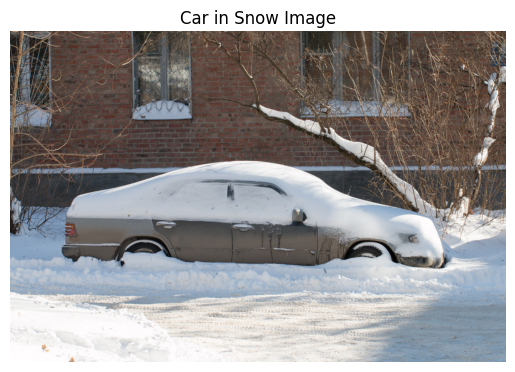

Image Size: (1023, 682)
Image Mode: RGB


In [6]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Load the image from Google Drive
image_path = '/content/drive/My Drive/Edgy Dataset/Snow_Car.jpg'
image = Image.open(image_path)

# Display the image using matplotlib
plt.imshow(image)
plt.axis('off')  # Hide axis
plt.title("Car in Snow Image")
plt.show()

# print the image details (size, mode, etc.)
print(f"Image Size: {image.size}")
print(f"Image Mode: {image.mode}")

In [7]:
# Convert the image to RGB if it has an alpha channel (4 channels)
if image.mode != 'RGB':
    image = image.convert('RGB')

# Preprocessing function for ResNet50 (ImageNet preprocessing)
preprocess = transforms.Compose([
    transforms.Resize(256),                         # Resize the image to 256 on the shortest side
    transforms.CenterCrop(224),                    # Crop the center to get a 224x224 image
    transforms.ToTensor(),                         # Convert image to tensor (C, H, W)
    transforms.Normalize(mean=[0.485, 0.456, 0.406],  # Normalize with ImageNet means and stds
                         std=[0.229, 0.224, 0.225])
])

# Preprocess the image
input_image = preprocess(image)
input_image = input_image.unsqueeze(0)  # Add batch dimension (1, C, H, W)

# Load a pretrained ResNet50 model
model = models.resnet50(pretrained=True)
model.eval()  # Set the model to evaluation mode

# Make a prediction
with torch.no_grad():
    output = model(input_image)

# Get the predicted class
_, predicted_class = torch.max(output, 1)
print(f'Predicted Class Index: {predicted_class.item()}')

# Load ImageNet class labels
!wget -q https://raw.githubusercontent.com/anishathalye/imagenet-simple-labels/master/imagenet-simple-labels.json
with open("imagenet-simple-labels.json") as f:
    labels = json.load(f)

# Print the predicted class label
predicted_label = labels[predicted_class.item()]
print(f'Predicted Label: {predicted_label}')

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 152MB/s]


Predicted Class Index: 450
Predicted Label: bobsleigh


### Evaluation of ResNet50 Prediction

ResNet50 incorrectly predicted the label "bobsleigh" for the image of a car in the snow. This misclassification likely occurred because the car's snow-covered appearance and elongated shape resemble features of a bobsleigh, leading the model to associate the image with this incorrect class.

## LIME

LIME is a technique that explains the predictions of any black-box machine learning model by approximating its behavior locally (near the instance of interest) using a simple interpretable model like linear regression or decision trees. The goal is to explain why a model made a particular prediction for a specific data point, rather than understanding the global behavior of the model. LIME approximates the decision function around the instance of interest using a linear model or some other simple interpretable model.

### Summary of Pros and Cons for LIME

| **Aspect**              | **Pros**                                                                 | **Cons**                                                                                          |
|-------------------------|-------------------------------------------------------------------------|---------------------------------------------------------------------------------------------------|
| **Interpretability**     | Provides **feature importance scores** that are intuitive and easy to understand | Explanations can be **inconsistent** across settings or experiments, leading to **instability**    |
| **Model Agnosticism**    | **Flexible** – can be applied to any black-box model, even if the model is replaced | Can struggle with **nonlinear decision boundaries** due to its use of linear approximations         |
| **Flexibility**          | Works well with **tabular data, text, and images**                        | **Defining the neighborhood** and optimizing the kernel width can be difficult                     |
| **Efficiency**           | Provides **local explanations** without requiring a global model to be retrained | Can be **computationally expensive** when a large number of perturbations is required              |
| **Local Approximation**  | Approximates the **local decision boundary** around the instance, making it simple | May provide **oversimplified explanations**, missing complex model behavior                        |
| **Bias**                 | Can work with various data types and models, remaining **intuitive**      | Can be **fooled** or used to **hide biases**, as the explanation may focus on irrelevant features  |

### Lime Image Explainer

[lime 0.1 documentation](https://lime-ml.readthedocs.io/en/latest/lime.html#module-lime.lime_image)

The LIME Image Explainer (Local Interpretable Model-agnostic Explanations) is a technique designed to explain the predictions of black-box models for image classification tasks. It works by perturbing the original image—typically by segmenting the image into superpixels (small regions of similar pixels) and selectively altering these regions to create multiple perturbed versions of the image. The model’s predictions for these perturbed images are then used to train an interpretable local surrogate model, such as a linear classifier, which approximates the model's behavior in the vicinity of the original image. LIME highlights the most important regions of the image that contributed to the model's prediction, providing human-understandable visual explanations for complex models like neural networks. This approach is especially useful for understanding why certain parts of an image strongly influenced the model’s classification decision.

### Summary of Pros and Cons for LIME Image Explainer

| **Aspect**              | **Pros**                                                                 | **Cons**                                                                                          |
|-------------------------|-------------------------------------------------------------------------|---------------------------------------------------------------------------------------------------|
| **Interpretability**     | Provides **visual explanations** by highlighting important image regions, making it intuitive | Explanations can be **inconsistent** across different image perturbations, leading to **instability** |
| **Model Agnosticism**    | **Flexible** – can be applied to any black-box image classifier, regardless of the model architecture | May struggle with highly **nonlinear decision boundaries** due to its linear approximations        |
| **Flexibility**          | Works well with **various image classification models**                   | Requires **careful tuning** of the perturbation process (e.g., superpixel size)                     |
| **Efficiency**           | Provides **local explanations** for specific images without retraining the model | Can be **computationally expensive** when a large number of image perturbations are required       |
| **Local Approximation**  | Approximates the **local decision boundary** of the model for each image   | May lead to **oversimplified explanations**, failing to capture complex model behaviors            |
| **Bias**                 | Provides **intuitive visual cues** for feature importance in images        | Can be **fooled** or manipulated to highlight **irrelevant regions**, leading to biased explanations |



In [8]:
def get_preprocess_transform():
    return transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

def get_input_transform():
    return transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor()
    ])

preprocess_transform = get_preprocess_transform()
input_transform = get_input_transform()

def batch_predict(images):
    model.eval()
    batch = torch.stack(tuple(preprocess_transform(Image.fromarray((img * 255).astype(np.uint8))) for img in images), dim=0)

    device = next(model.parameters()).device
    batch = batch.to(device)

    logits = model(batch)
    probs = torch.nn.functional.softmax(logits, dim=1)
    return probs.detach().cpu().numpy()

# Load and preprocess the image
img = Image.open(image_path)
if img.mode != 'RGB':
    img = img.convert('RGB')
input_img = input_transform(img)

# Initialize LIME image explainer
explainer = lime_image.LimeImageExplainer(random_state=42)

# Get the explanation
explanation = explainer.explain_instance(
    np.array(input_img.permute(1, 2, 0)),
    batch_predict,
    top_labels=5,
    hide_color=0,
    num_samples=1000
)

# # Visualize the explanations for top 5 classes
# plt.figure(figsize=(20, 4*5))
# for idx, label in enumerate(explanation.top_labels):
#     temp, mask = explanation.get_image_and_mask(
#         label, positive_only=True, num_features=5, hide_rest=True
#     )
#     img_boundary = mark_boundaries(temp/255.0, mask)

#     plt.subplot(5, 2, 2*idx+1)
#     plt.imshow(img)
#     plt.title(f'Original Image')
#     plt.axis('off')

#     plt.subplot(5, 2, 2*idx+2)
#     plt.imshow(img_boundary)
#     plt.title(f'LIME Explanation for {labels[label]}')
#     plt.axis('off')

# # plt.tight_layout()
# # plt.savefig('/content/drive/My Drive/XAI_sample/lime_explanation_top5.png')
# # plt.show()

# # Print the top 5 predictions with their probabilities
# print("Top 5 predictions:")
# probs = batch_predict(np.expand_dims(np.array(input_img.permute(1, 2, 0)), axis=0))[0]
# top5_idx = probs.argsort()[-5:][::-1]
# for idx in top5_idx:
#     print(f"{labels[idx]}: {probs[idx]:.4f}")

  0%|          | 0/1000 [00:00<?, ?it/s]

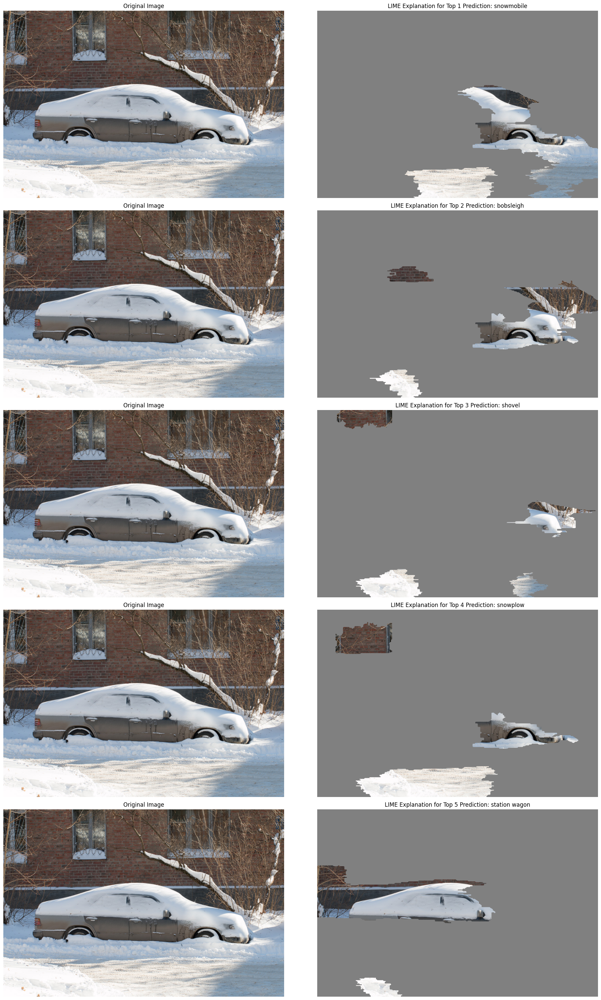

In [9]:
# Function to create perturbation visualization
def perturbation_visualization(image, mask):
    # Resize mask to match image dimensions
    mask_resized = zoom(mask, (image.size[1] / mask.shape[0], image.size[0] / mask.shape[1]), order=1)
    mask_resized = np.clip(mask_resized, 0, 1)  # Ensure values are between 0 and 1

    # Create a gray image
    gray_color = (128, 128, 128)  # Mid-gray color
    gray_image = Image.new('RGB', image.size, gray_color)

    # Create the overlay
    image_array = np.array(image)
    gray_array = np.array(gray_image)
    mask_3d = np.expand_dims(mask_resized, axis=2)
    overlay = (image_array * mask_3d + gray_array * (1 - mask_3d)).astype(np.uint8)

    return Image.fromarray(overlay)

# Visualize the explanations for top 5 classes
plt.figure(figsize=(20, 6*5))
for idx, label in enumerate(explanation.top_labels):
    temp, mask = explanation.get_image_and_mask(
        label, positive_only=True, num_features=5, hide_rest=False
    )

    perturbed_img = perturbation_visualization(img, mask)

    plt.subplot(5, 2, 2*idx+1)
    plt.imshow(img)
    plt.title(f'Original Image')
    plt.axis('off')

    plt.subplot(5, 2, 2*idx+2)
    plt.imshow(perturbed_img)
    plt.title(f'LIME Explanation for Top {idx+1} Prediction: {labels[label]}')
    plt.axis('off')

plt.tight_layout()
plt.show()

# plt.tight_layout()
# plt.savefig('/content/drive/My Drive/XAI_sample/lime_explanation_full_gray_perturbation_top5.png')
# plt.show()

### Evaluation of the LIME Explanation

The LIME interpretation for ResNet50's "bobsleigh" prediction highlights the front part of the car, which resembles the shape of a bobsleigh, as the primary feature influencing the model's decision. For other predictions, such as "snowmobile," the focus remains on the front part of the car, reflecting a similar reasoning. For "shovel," the model shifts attention to the snow and a small portion of the car, while "snowplow" highlights the snow and the car's wheel. For "station wagon," LIME emphasizes the body of the car. These varying focus areas reveal the model's reliance on specific visual elements, such as the car's shape and its interaction with the snow, while struggling to holistically interpret the scene.



## Grad-CAM

Grad-CAM (Gradient-weighted Class Activation Mapping) is a visualization technique used to interpret the decisions of convolutional neural networks (CNNs), especially in image classification tasks. Unlike methods such as LIME that approximate the model's behavior using surrogate models, Grad-CAM uses the internal gradients of the model to produce a coarse localization map of the important regions in an image that contributed to the model’s prediction. It achieves this by backpropagating the gradients of the target class score with respect to the feature maps of the final convolutional layer. These gradients are then weighted and aggregated to highlight the regions in the image most relevant to the prediction.

### Summary of Pros and Cons for Grad-CAM

| **Aspect**              | **Pros**                                                                 | **Cons**                                                                                          |
|-------------------------|-------------------------------------------------------------------------|---------------------------------------------------------------------------------------------------|
| **Interpretability**     | Produces intuitive heatmaps, showing regions of interest in the image. | Heatmaps can sometimes be too coarse to pinpoint specific features.                              |
| **Handling Complexity**  | Handles complex and nonlinear models effectively by leveraging gradients. | Limited to analyzing the final convolutional layer, potentially missing deeper interactions.       |
| **Model Dependency**     | Provides insights directly tied to the model’s internal structure.      | Cannot be applied to non-CNN architectures or requires modification for non-visual data.          |
| **Efficiency**           | Relatively efficient since it reuses gradients from backpropagation.   | Computational cost increases for high-resolution images or deeper networks.                       |
| **Visual Output**        | Highlights key regions responsible for predictions, aiding decision-making. | May focus on multiple irrelevant regions if gradients are noisy or poorly calibrated.             |

### Grad-CAM in Practice

Grad-CAM is particularly useful for understanding and debugging CNN-based models in critical applications such as healthcare and autonomous vehicles. For example, in medical imaging, Grad-CAM can identify whether the model is focusing on clinically relevant regions, such as the lungs in chest X-rays, when diagnosing pneumonia. Similarly, in autonomous driving, it can highlight important features like road signs or pedestrians. By providing visually interpretable feedback on the model's predictions, Grad-CAM helps build trust in AI systems and enables researchers and practitioners to diagnose issues or refine model performance.

In [10]:
def get_last_conv_layer(model):
    """
    Get the last convolutional layer from ResNet
    """
    return model.layer4[-1]  # For ResNet, last conv layer is in layer4

def overlay_heatmap(img, heatmap, alpha=0.4):
    """
    Overlay heatmap on image with improved contrast
    """
    # Resize heatmap to match image size
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))

    # Apply contrast enhancement to heatmap
    heatmap = (heatmap * 255).astype(np.uint8)
    heatmap = cv2.equalizeHist(heatmap)  # Enhance contrast

    # Apply color mapping with enhanced visibility
    heatmap_colored = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    # Ensure input image is in correct format
    if img.dtype == np.float32 or img.dtype == np.float64:
        img = (img * 255).astype(np.uint8)

    if len(img.shape) == 2:
        img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
    elif len(img.shape) == 3 and img.shape[2] == 1:
        img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)

    output = cv2.addWeighted(img, 1-alpha, heatmap_colored, alpha, 0)
    return output

def compute_gradcam_topn(model, img_tensor, target_layer, top_n=5):
    """
    Compute Grad-CAM heatmap for top N predictions
    """
    model.eval()

    # Forward pass first to get top N predictions
    with torch.no_grad():
        output = model(img_tensor)
        probs = F.softmax(output, dim=1)
        top_probs, top_idx = torch.topk(probs, top_n, dim=1)

    heatmaps = []
    predictions = []

    for i in range(top_n):
        # Get the feature maps and model output
        feature_maps = []
        gradients = []

        # Hook for feature maps
        def save_features(module, input, output):
            feature_maps.append(output.detach())

        # Hook for gradients
        def save_gradients(module, grad_input, grad_output):
            gradients.append(grad_output[0].detach())

        # Register hooks
        handle_features = target_layer.register_forward_hook(save_features)
        handle_gradients = target_layer.register_full_backward_hook(save_gradients)

        # Forward pass
        output = model(img_tensor)

        # Backward pass for current class
        model.zero_grad()
        output[:, top_idx[0][i]].backward(retain_graph=(i < top_n-1))

        # Get feature maps and gradients
        fmaps = feature_maps[0][0]
        grads = gradients[0][0]

        # Global average pooling of gradients
        weights = torch.mean(grads, dim=(1, 2))

        # Weight combination of forward activation maps
        heatmap = torch.sum(fmaps * weights.view(-1, 1, 1), dim=0)

        # ReLU and normalize
        heatmap = F.relu(heatmap)
        heatmap = heatmap - heatmap.min()
        heatmap = heatmap / (heatmap.max() + 1e-10)

        # Clean up hooks
        handle_features.remove()
        handle_gradients.remove()

        heatmaps.append(heatmap.cpu().numpy())
        predictions.append((top_idx[0][i].item(), top_probs[0][i].item()))

    return heatmaps, predictions

def process_single_image_topn(image_path, model, top_n=5):
    """
    Process a single image and generate Grad-CAM visualization for top N predictions
    """
    # Use exactly the same transforms as LIME
    preprocess_transform = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    # Load and preprocess image
    img = Image.open(image_path)
    if img.mode != 'RGB':
        img = img.convert('RGB')

    # Store original size image for visualization
    original_img = img.copy()

    # Apply the same preprocessing as LIME
    img_tensor = preprocess_transform(img).unsqueeze(0)

    # Get last conv layer
    target_layer = get_last_conv_layer(model)

    # Compute Grad-CAM for top N predictions
    heatmaps, predictions = compute_gradcam_topn(model, img_tensor, target_layer, top_n)

    # Create visualization
    plt.figure(figsize=(20, 8))

    # Original image
    plt.subplot(2, 3, 1)
    plt.imshow(img)
    plt.title("Original Image")
    plt.axis('off')

    # ImageNet class labels
    try:
        import json
        import urllib.request

        # Download ImageNet class labels
        labels_url = "https://raw.githubusercontent.com/anishathalye/imagenet-simple-labels/master/imagenet-simple-labels.json"
        with urllib.request.urlopen(labels_url) as url:
            labels = json.loads(url.read().decode())
    except:
        labels = [str(i) for i in range(1000)]

    # Heatmap overlays for top predictions
    img_array = np.array(img)
    for i, (heatmap, (class_idx, prob)) in enumerate(zip(heatmaps, predictions)):
        plt.subplot(2, 3, i + 2)
        img_overlayed = overlay_heatmap(img_array.copy(), heatmap)
        plt.imshow(cv2.cvtColor(img_overlayed, cv2.COLOR_BGR2RGB))
        plt.title(f"Grad-Cam Explaination For Top {i+1} Prediction: {labels[class_idx]}")
        plt.axis('off')

    plt.tight_layout()
    plt.show()

    return heatmaps, predictions

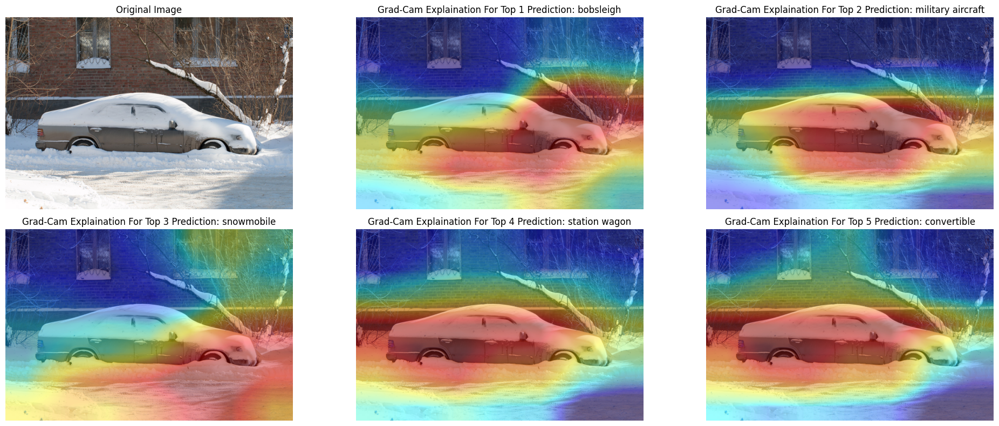

In [11]:
heatmaps, predictions = process_single_image_topn(image_path, model, top_n=5)

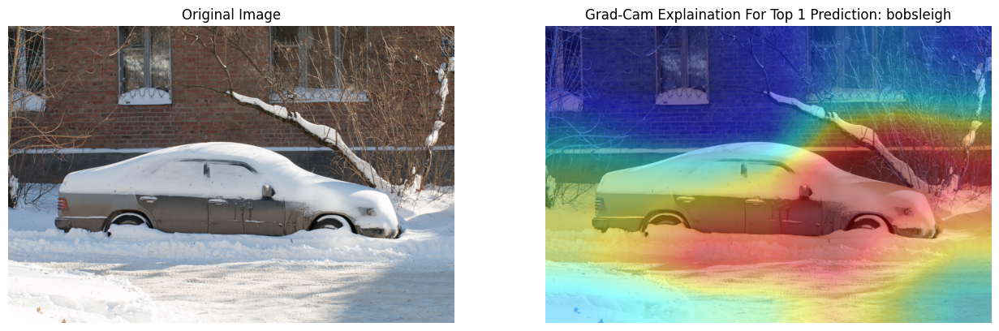

In [12]:
# Process the image and visualize Grad-CAM for top 1 predictions
heatmaps, predictions = process_single_image_topn(image_path, model, top_n=1)

## Grad-Cam Evaluation

The Grad-CAM interpretation for ResNet50 provides limited insights, as it shows minimal variation in the focus across the image for the different predictions. The attention remains broadly centered on the car and surrounding snow, failing to distinguish between the features contributing to each prediction, which diminishes its usefulness in understanding the model's decision-making process.

## Anchors Explaination

Anchors is a type of if-then rule used to explain individual predictions made by machine learning models. Unlike LIME, which approximates complex decision boundaries using local linear models, Anchors provide decision rules that "anchor" the prediction to certain features or conditions. When these conditions hold true, the model’s prediction remains consistent with high probability, even if other features change.

### Summary of Pros and Cons for Anchors

| **Aspect**              | **Pros**                                                       | **Cons**                                                                                          |
|-------------------------|---------------------------------------------------------------|---------------------------------------------------------------------------------------------------|
| **Interpretability**     | Rules are easy to understand—if-then format is intuitive      | Requires careful parameter tuning, which can be challenging                                        |
| **Handling Complexity**  | Works well with nonlinear or complex models                   | Perturbation function needs to be custom-designed for each specific use case                       |
| **Model Agnosticism**    | Can be used with any model, model agnostic        | Coverage is hard to define and measure in some domains, making it difficult to compare             |
| **Efficiency**           | Highly efficient search algorithms like beam search           | Imbalanced data can result in biased perturbation spaces unless careful mitigation is used         |

### AnchorImage

[alibi.explainers.anchors.anchor_image module documentation](https://docs.seldon.io/projects/alibi/en/latest/api/alibi.explainers.anchors.anchor_image.html)

The AnchorImage explainer is an extension of the Anchors approach designed specifically for image classification tasks, providing highly interpretable, rule-based explanations for predictions made by complex models such as deep neural networks. Instead of relying on global model behavior or linear approximations, AnchorImage identifies if-then rules that are based on superpixels, or segmented regions of the image. These anchors represent key areas of the image that, when present, strongly influence the model’s prediction. The method generates a set of perturbed images by altering different regions, and it tests whether the model’s prediction remains consistent when the anchor region is unchanged. This allows AnchorImage to provide a highly stable and visual explanation by highlighting the specific areas of the image responsible for the model’s decision, making it an effective tool for understanding predictions in complex models like convolutional neural networks (CNNs).

### Summary of Pros and Cons for AnchorImage Explainer

| **Aspect**              | **Pros**                                                                 | **Cons**                                                                                          |
|-------------------------|-------------------------------------------------------------------------|---------------------------------------------------------------------------------------------------|
| **Interpretability**     | Provides easy-to-understand **if-then rules** based on image superpixels, making visual explanations intuitive | Requires **careful parameter tuning** for perturbations, such as defining superpixels and thresholds |
| **Handling Complexity**  | Works well with **nonlinear and complex models**, such as deep neural networks | Perturbation function and superpixel segmentation need to be **custom-designed** for each image dataset |
| **Model Agnosticism**    | Can be used with **any image classification model**, remaining model-agnostic | **Coverage** can be hard to measure, and it is difficult to define in certain domains               |
| **Efficiency**           | Uses **efficient search algorithms** like beam search to find anchor regions | **Computationally expensive** when generating and testing a large number of image perturbations     |
| **Stability**            | Provides **stable explanations** by identifying key superpixels that consistently influence predictions | **Imbalanced data** can lead to anchors focusing on irrelevant regions or failing to generalize     |


In [13]:
def preprocess_image(image_path):
    transform = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    img = Image.open(image_path).convert('RGB')
    return transform(img).unsqueeze(0)

def predict_fn(images):
    model.eval()
    with torch.no_grad():
        if isinstance(images, np.ndarray):
            images = torch.from_numpy(images).permute(0, 3, 1, 2).float()
        outputs = model(images)
    return outputs.numpy()

# Load and preprocess the image
input_tensor = preprocess_image(image_path)
input_image = input_tensor.squeeze().permute(1, 2, 0).numpy()

# Initialize the AnchorImage explainer
explainer = AnchorImage(
    predict_fn,
    image_shape=input_image.shape,
    segmentation_fn='quickshift',
    segmentation_kwargs={'kernel_size': 4, 'max_dist': 200, 'ratio': 0.2},
    images_background=None,
    seed=42
)

# Generate the explanation
explanation = explainer.explain(input_image, threshold=0.95, p_sample=0.5, tau=0.25)

Image shape: (224, 224, 3)
Segments shape: (224, 224)
Anchor shape: (224, 224, 3)
Processed segments shape: (224, 224)


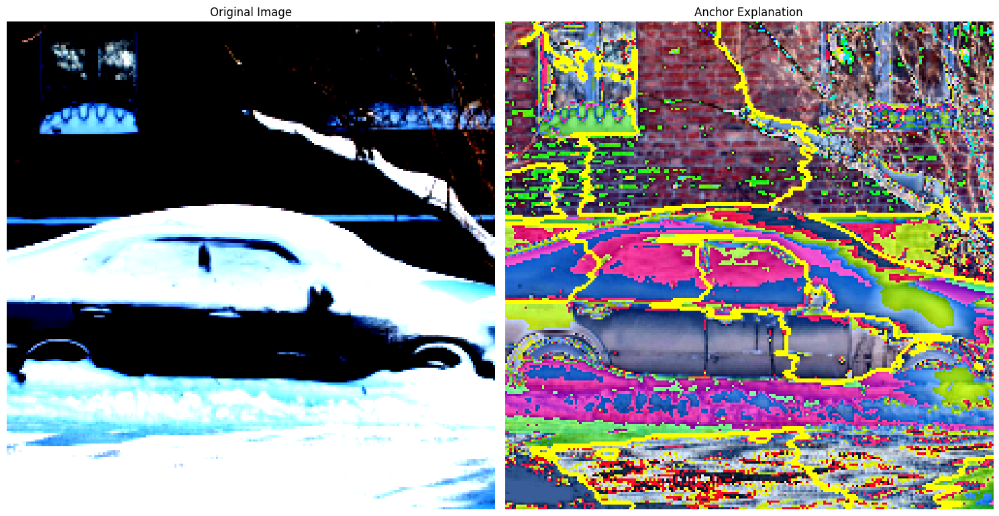

In [14]:
def visualize_anchor(image, exp, fig_size=(15, 15)):
    anchor = exp.anchor
    segments = exp.segments

    print(f"Image shape: {image.shape}")
    print(f"Segments shape: {segments.shape}")
    print(f"Anchor shape: {anchor.shape}")

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=fig_size)

    ax1.imshow(image)
    ax1.set_title('Original Image')
    ax1.axis('off')

    # Ensure segments is 2D
    if segments.ndim == 3:
        segments = segments[:,:,0]
    print(f"Processed segments shape: {segments.shape}")

    # Create a boolean mask for the anchor
    temp_img = np.zeros(segments.shape, dtype=bool)
    if anchor.ndim == 3:
        # If anchor is 3D, we assume it's a boolean mask
        temp_img = anchor[:,:,0].astype(bool)
    elif anchor.ndim == 1:
        # If anchor is 1D, we assume it's a list of segment indices
        for seg_idx in anchor:
            temp_img[segments == seg_idx] = True
    else:
        print("Unexpected anchor shape. Please check the anchor data.")

    # Ensure image is in the correct format for mark_boundaries
    if image.dtype != np.uint8:
        image = (image * 255).astype(np.uint8)

    highlighted_img = mark_boundaries(image, temp_img, color=(1, 1, 0), mode='thick')
    ax2.imshow(highlighted_img)
    ax2.set_title('Anchor Explanation')
    ax2.axis('off')

    plt.tight_layout()
    plt.show()

    # # Save the plot
    # plt.savefig('/content/drive/My Drive/XAI_sample/anchor_explanation.png')
    # print("SHAP explanation plot saved to /content/drive/My Drive/XAI_sample/anchor_explanation.png")

# Usage example:
visualize_anchor(input_image, explanation)

In [15]:
def load_imagenet_classes():
    url = "https://s3.amazonaws.com/deep-learning-models/image-models/imagenet_class_index.json"
    fname = shap.datasets.cache(url)
    with open(fname) as f:
        class_names = json.load(f)
    return {int(key): value[1] for key, value in class_names.items()}

imagenet_classes = load_imagenet_classes()

def print_simple_anchor_explanation(explanation):
    pred_class = explanation.raw['prediction']

    # Handle the case where pred_class is a numpy array
    if isinstance(pred_class, np.ndarray):
        pred_class = pred_class.item() if pred_class.size == 1 else pred_class.tolist()

    # Try to get the class name, if pred_class is a single integer
    if isinstance(pred_class, int):
        class_name = imagenet_classes.get(pred_class, "Unknown")
        print(f"\nPredicted class: {pred_class} ({class_name})")
    else:
        print(f"\nPredicted class: {pred_class}")

    print(f"Anchor precision: {explanation.precision:.2f}")
    print(f"Anchor coverage: {explanation.coverage:.2f}")

Image shape: (224, 224, 3)
Segments shape: (224, 224)
Anchor shape: (224, 224, 3)
Processed segments shape: (224, 224)


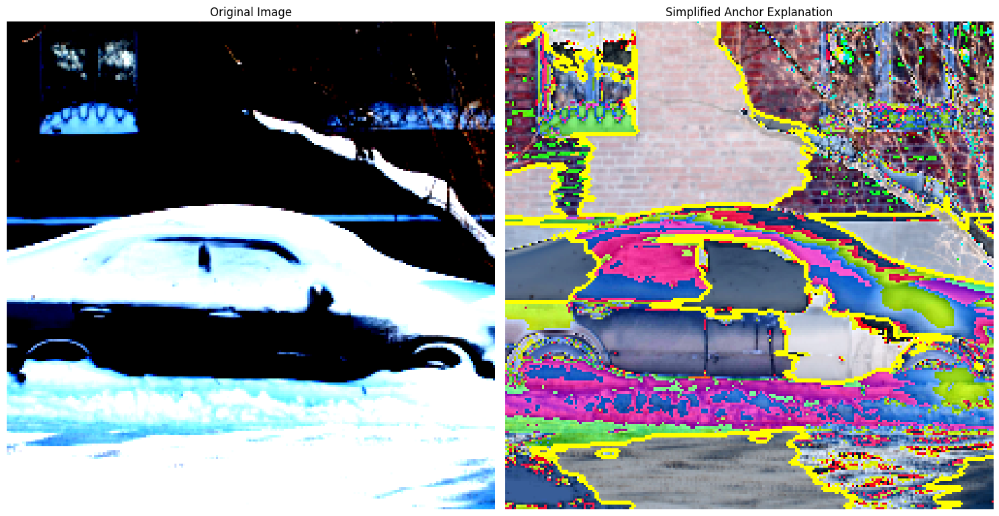


Predicted class: 450 (bobsled)
Anchor precision: 0.98
Anchor coverage: 0.00


In [16]:
def visualize_simplified_anchor(image, exp, fig_size=(15, 15)):
    anchor = exp.anchor
    segments = exp.segments

    print(f"Image shape: {image.shape}")
    print(f"Segments shape: {segments.shape}")
    print(f"Anchor shape: {anchor.shape}")

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=fig_size)

    ax1.imshow(image)
    ax1.set_title('Original Image')
    ax1.axis('off')

    # Ensure segments is 2D
    if segments.ndim == 3:
        segments = segments[:,:,0]
    print(f"Processed segments shape: {segments.shape}")

    # Create a boolean mask for the anchor
    temp_img = np.zeros(segments.shape, dtype=bool)
    if anchor.ndim == 3:
        # If anchor is 3D, we assume it's a boolean mask
        temp_img = anchor[:,:,0].astype(bool)
    elif anchor.ndim == 1:
        # If anchor is 1D, we assume it's a list of segment indices
        for seg_idx in anchor:
            temp_img[segments == seg_idx] = True
    else:
        print("Unexpected anchor shape. Please check the anchor data.")

    # Simplify the visualization
    simplified_img = image.copy()
    simplified_img[~temp_img] = simplified_img[~temp_img] * 0.3  # Darken non-anchor regions

    # Ensure image is in the correct format for mark_boundaries
    if simplified_img.dtype != np.uint8:
        simplified_img = (simplified_img * 255).astype(np.uint8)

    highlighted_img = mark_boundaries(simplified_img, temp_img, color=(1, 1, 0), mode='thick')
    ax2.imshow(highlighted_img)
    ax2.set_title('Simplified Anchor Explanation')
    ax2.axis('off')

    plt.tight_layout()
    plt.show()

    # # Save the plot
    # save_path = '/content/drive/My Drive/XAI_sample/simplified_anchor_explanation.png'
    # plt.savefig(save_path)
    # print(f"Simplified anchor explanation plot saved to {save_path}")

visualize_simplified_anchor(input_image, explanation)
print_simple_anchor_explanation(explanation)

### Anchor Evaluation

The Anchor explanation for ResNet50 highlights the shape of the car, the wall, and the surrounding snow as the key features influencing the prediction of "bobsleigh" (Predicted class: 450). With an anchor precision of 0.98, the explanation is highly reliable, indicating that these features consistently lead to the same prediction. However, the anchor coverage of 0.00 suggests that this explanation applies only to this specific instance, revealing the model's reliance on a narrow, instance-specific set of features rather than a generalized understanding of the scene. This instance-specific focus underscores the model's difficulty in accurately interpreting complex snow-covered environments.

## VGG16 Model Prediction

In [17]:
# Load and preprocess the image
image_path = '/content/drive/My Drive/Edgy Dataset/Snow_Car.jpg'
image = Image.open(image_path)

# Convert the image to RGB if it has an alpha channel (4 channels)
if image.mode != 'RGB':
    image = image.convert('RGB')

# Preprocessing function for VGG16 (ImageNet preprocessing)
preprocess = transforms.Compose([
    transforms.Resize(256),                         # Resize the image to 256 on the shortest side
    transforms.CenterCrop(224),                    # Crop the center to get a 224x224 image
    transforms.ToTensor(),                         # Convert image to tensor (C, H, W)
    transforms.Normalize(mean=[0.485, 0.456, 0.406],  # Normalize with ImageNet means and stds
                         std=[0.229, 0.224, 0.225])
])

# Preprocess the image
input_image = preprocess(image)
input_image = input_image.unsqueeze(0)  # Add batch dimension (1, C, H, W)

# Load a pretrained VGG16 model
model = models.vgg16(pretrained=True)
model.eval()  # Set the model to evaluation mode

# Make a prediction
with torch.no_grad():
    output = model(input_image)

# Get the predicted class
_, predicted_class = torch.max(output, 1)
print(f'Predicted Class Index: {predicted_class.item()}')

# Load ImageNet class labels
!wget -q https://raw.githubusercontent.com/anishathalye/imagenet-simple-labels/master/imagenet-simple-labels.json
with open("imagenet-simple-labels.json") as f:
    labels = json.load(f)

# Print the predicted class label
predicted_label = labels[predicted_class.item()]
print(f'Predicted Label: {predicted_label}')

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 223MB/s]


Predicted Class Index: 895
Predicted Label: military aircraft


### Evaluation on VGG16's Prediction

VGG16 incorrectly predicted the label "military aircraft" for the image of a car in the snow. This misclassification suggests that the model was influenced by the elongated and partially obscured shape of the snow-covered car, which it associated with the silhouette of a military aircraft, rather than recognizing it as a car.

### LIME

In [18]:
def get_preprocess_transform():
    return transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

def get_input_transform():
    return transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor()
    ])

preprocess_transform = get_preprocess_transform()
input_transform = get_input_transform()

def batch_predict(images):
    model.eval()
    batch = torch.stack(tuple(preprocess_transform(Image.fromarray((img * 255).astype(np.uint8))) for img in images), dim=0)

    device = next(model.parameters()).device
    batch = batch.to(device)

    logits = model(batch)
    probs = torch.nn.functional.softmax(logits, dim=1)
    return probs.detach().cpu().numpy()

# Load and preprocess the image
img = Image.open(image_path)
if img.mode != 'RGB':
    img = img.convert('RGB')
input_img = input_transform(img)

# Initialize LIME image explainer
explainer = lime_image.LimeImageExplainer(random_state=42)

# Get the explanation
explanation = explainer.explain_instance(
    np.array(input_img.permute(1, 2, 0)),
    batch_predict,
    top_labels=5,
    hide_color=0,
    num_samples=1000
)

  0%|          | 0/1000 [00:00<?, ?it/s]

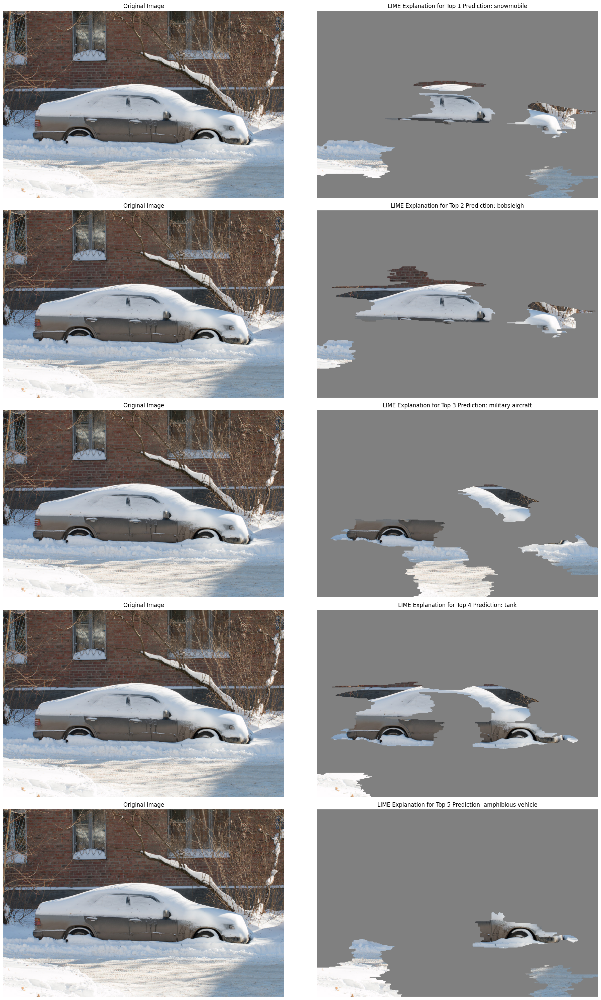

In [19]:
# Function to create perturbation visualization
def perturbation_visualization(image, mask):
    # Resize mask to match image dimensions
    mask_resized = zoom(mask, (image.size[1] / mask.shape[0], image.size[0] / mask.shape[1]), order=1)
    mask_resized = np.clip(mask_resized, 0, 1)  # Ensure values are between 0 and 1

    # Create a gray image
    gray_color = (128, 128, 128)  # Mid-gray color
    gray_image = Image.new('RGB', image.size, gray_color)

    # Create the overlay
    image_array = np.array(image)
    gray_array = np.array(gray_image)
    mask_3d = np.expand_dims(mask_resized, axis=2)
    overlay = (image_array * mask_3d + gray_array * (1 - mask_3d)).astype(np.uint8)

    return Image.fromarray(overlay)

# Visualize the explanations for top 5 classes
plt.figure(figsize=(20, 6*5))
for idx, label in enumerate(explanation.top_labels):
    temp, mask = explanation.get_image_and_mask(
        label, positive_only=True, num_features=5, hide_rest=False
    )

    perturbed_img = perturbation_visualization(img, mask)

    plt.subplot(5, 2, 2*idx+1)
    plt.imshow(img)
    plt.title(f'Original Image')
    plt.axis('off')

    plt.subplot(5, 2, 2*idx+2)
    plt.imshow(perturbed_img)
    plt.title(f'LIME Explanation for Top {idx+1} Prediction: {labels[label]}')
    plt.axis('off')

plt.tight_layout()
plt.show()

### LIME Evaluation

The LIME interpretation for VGG16's predictions highlights the shape of the uncovered portions of the car as the key feature influencing its decisions. For the top prediction "military aircraft," the focus remains on the car's elongated shape, while alternative predictions such as "snowmobile" and "bobsleigh" similarly emphasize the car's front and body. For "tank" and "amphibious vehicle," the model shifts attention to the general shape of the car and its interaction with the surrounding snow. These explanations reveal that VGG16 associates the car's partially visible, snow-covered structure with various objects that share similar shapes or silhouettes, demonstrating the model's difficulty in distinguishing between contextually different but visually similar features.








## Grad-Cam

In [20]:
def get_last_conv_layer(model):
    """
    Get the last convolutional layer from VGG16.
    """
    # VGG16 stores convolutional layers in the 'features' attribute
    return list(model.features.children())[-1]


def overlay_heatmap(img, heatmap, alpha=0.4):
    """
    Overlay heatmap on image with improved contrast.
    """
    # Resize heatmap to match image size
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))

    # Apply contrast enhancement to heatmap
    heatmap = (heatmap * 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    # Ensure input image is in correct format
    if img.dtype == np.float32 or img.dtype == np.float64:
        img = (img * 255).astype(np.uint8)

    if len(img.shape) == 2:
        img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)

    output = cv2.addWeighted(img, 1 - alpha, heatmap, alpha, 0)
    return output


def compute_gradcam_topn(model, img_tensor, target_layer, top_n=5):
    """
    Compute Grad-CAM heatmap for top N predictions.
    """
    model.eval()

    # Forward pass first to get top N predictions
    with torch.no_grad():
        output = model(img_tensor)
        probs = F.softmax(output, dim=1)
        top_probs, top_idx = torch.topk(probs, top_n, dim=1)

    heatmaps = []
    predictions = []

    for i in range(top_n):
        # Get the feature maps and model output
        feature_maps = []
        gradients = []

        # Hook for feature maps
        def save_features(module, input, output):
            feature_maps.append(output.detach())

        # Hook for gradients
        def save_gradients(module, grad_input, grad_output):
            gradients.append(grad_output[0].detach())

        # Register hooks
        handle_features = target_layer.register_forward_hook(save_features)
        handle_gradients = target_layer.register_full_backward_hook(save_gradients)

        # Forward pass
        output = model(img_tensor)

        # Backward pass for current class
        model.zero_grad()
        output[:, top_idx[0][i]].backward(retain_graph=(i < top_n - 1))

        # Get feature maps and gradients
        fmaps = feature_maps[0][0]
        grads = gradients[0][0]

        # Global average pooling of gradients
        weights = torch.mean(grads, dim=(1, 2))

        # Weight combination of forward activation maps
        heatmap = torch.sum(fmaps * weights.view(-1, 1, 1), dim=0)

        # ReLU and normalize
        heatmap = F.relu(heatmap)
        heatmap = heatmap - heatmap.min()
        heatmap = heatmap / (heatmap.max() + 1e-10)

        # Clean up hooks
        handle_features.remove()
        handle_gradients.remove()

        heatmaps.append(heatmap.cpu().numpy())
        predictions.append((top_idx[0][i].item(), top_probs[0][i].item()))

    return heatmaps, predictions


def process_single_image_topn(image_path, model, top_n=5):
    """
    Process a single image and generate Grad-CAM visualization for top N predictions.
    """
    # Preprocessing function for VGG16
    preprocess_transform = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    # Load and preprocess image
    img = Image.open(image_path)
    if img.mode != 'RGB':
        img = img.convert('RGB')

    # Store original size image for visualization
    original_img = img.copy()

    # Apply preprocessing
    img_tensor = preprocess_transform(img).unsqueeze(0)

    # Get last convolutional layer
    target_layer = get_last_conv_layer(model)

    # Compute Grad-CAM for top N predictions
    heatmaps, predictions = compute_gradcam_topn(model, img_tensor, target_layer, top_n)

    # Visualization
    plt.figure(figsize=(20, 8))

    # Original image
    plt.subplot(2, 3, 1)
    plt.imshow(original_img)
    plt.title("Original Image")
    plt.axis('off')

    # ImageNet class labels
    try:
        import json
        import urllib.request

        # Download ImageNet class labels
        labels_url = "https://raw.githubusercontent.com/anishathalye/imagenet-simple-labels/master/imagenet-simple-labels.json"
        with urllib.request.urlopen(labels_url) as url:
            labels = json.loads(url.read().decode())
    except:
        labels = [str(i) for i in range(1000)]

    # Heatmap overlays for top predictions
    img_array = np.array(img)
    for i, (heatmap, (class_idx, prob)) in enumerate(zip(heatmaps, predictions)):
        plt.subplot(2, 3, i + 2)
        img_overlayed = overlay_heatmap(img_array.copy(), heatmap)
        plt.imshow(cv2.cvtColor(img_overlayed, cv2.COLOR_BGR2RGB))
        plt.title(f"Grad-Cam Explaination For Top {i+1} Prediction: {labels[class_idx]}")
        plt.axis('off')

    plt.tight_layout()
    plt.show()

    return heatmaps, predictions

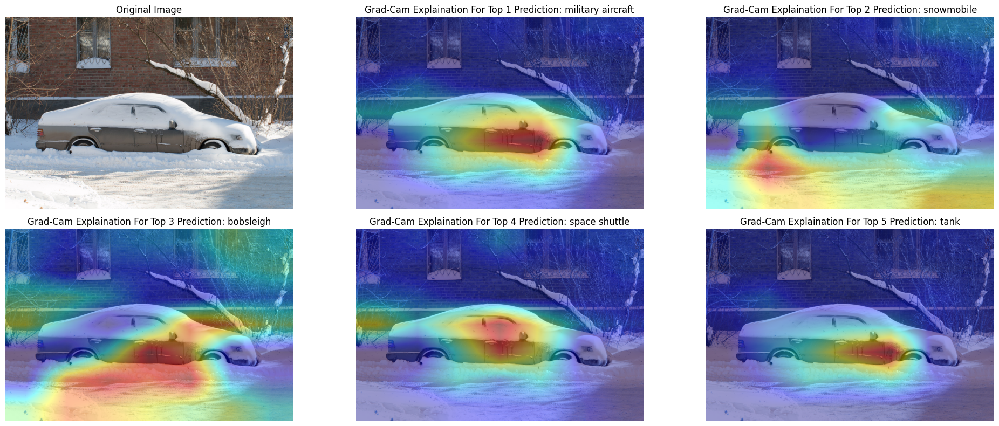

In [21]:
# Process the image and visualize Grad-CAM for top 5 predictions
heatmaps, predictions = process_single_image_topn(image_path, model, top_n=5)

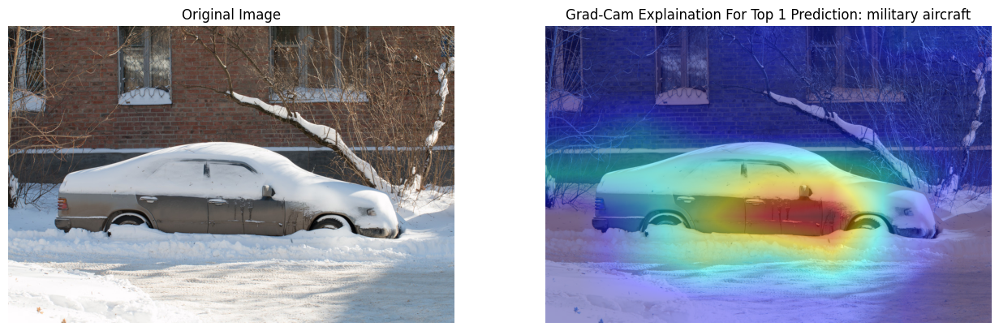

In [22]:
# Process the image and visualize Grad-CAM for top 1 predictions
heatmaps, predictions = process_single_image_topn(image_path, model, top_n=1)

### Grad-Cam Evaluation

The Grad-CAM interpretation for VGG16 shows a focus on different parts of the car for its predictions, such as the uncovered sections and surrounding areas. However, the explanations lack depth and clarity, as the highlighted regions do not distinctly explain the reasoning behind specific predictions like "military aircraft" or "bobsleigh." This general and unfocused attention limits the utility of Grad-CAM in providing meaningful insights into VGG16's decision-making process for this image.

## Anchor

In [23]:
def preprocess_image(image_path):
    transform = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    img = Image.open(image_path).convert('RGB')
    return transform(img).unsqueeze(0)

def predict_fn(images):
    model.eval()
    with torch.no_grad():
        if isinstance(images, np.ndarray):
            images = torch.from_numpy(images).permute(0, 3, 1, 2).float()
        outputs = model(images)
    return outputs.numpy()

# Load and preprocess the image
input_tensor = preprocess_image(image_path)
input_image = input_tensor.squeeze().permute(1, 2, 0).numpy()

# Initialize the AnchorImage explainer
explainer = AnchorImage(
    predict_fn,
    image_shape=input_image.shape,
    segmentation_fn='quickshift',
    segmentation_kwargs={'kernel_size': 4, 'max_dist': 200, 'ratio': 0.2},
    images_background=None,
    seed=42
)

# Generate the explanation
explanation = explainer.explain(input_image, threshold=0.95, p_sample=0.5, tau=0.25)

Image shape: (224, 224, 3)
Segments shape: (224, 224)
Anchor shape: (224, 224, 3)
Processed segments shape: (224, 224)


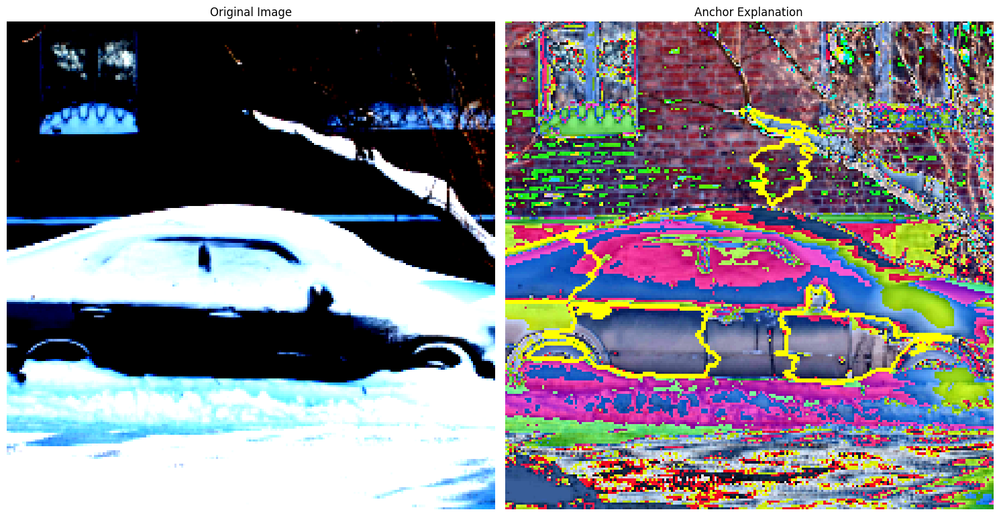

In [24]:
def visualize_anchor(image, exp, fig_size=(15, 15)):
    anchor = exp.anchor
    segments = exp.segments

    print(f"Image shape: {image.shape}")
    print(f"Segments shape: {segments.shape}")
    print(f"Anchor shape: {anchor.shape}")

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=fig_size)

    ax1.imshow(image)
    ax1.set_title('Original Image')
    ax1.axis('off')

    # Ensure segments is 2D
    if segments.ndim == 3:
        segments = segments[:,:,0]
    print(f"Processed segments shape: {segments.shape}")

    # Create a boolean mask for the anchor
    temp_img = np.zeros(segments.shape, dtype=bool)
    if anchor.ndim == 3:
        # If anchor is 3D, we assume it's a boolean mask
        temp_img = anchor[:,:,0].astype(bool)
    elif anchor.ndim == 1:
        # If anchor is 1D, we assume it's a list of segment indices
        for seg_idx in anchor:
            temp_img[segments == seg_idx] = True
    else:
        print("Unexpected anchor shape. Please check the anchor data.")

    # Ensure image is in the correct format for mark_boundaries
    if image.dtype != np.uint8:
        image = (image * 255).astype(np.uint8)

    highlighted_img = mark_boundaries(image, temp_img, color=(1, 1, 0), mode='thick')
    ax2.imshow(highlighted_img)
    ax2.set_title('Anchor Explanation')
    ax2.axis('off')

    plt.tight_layout()
    plt.show()

    # # Save the plot
    # plt.savefig('/content/drive/My Drive/XAI_sample/anchor_explanation.png')
    # print("SHAP explanation plot saved to /content/drive/My Drive/XAI_sample/anchor_explanation.png")

# Usage example:
visualize_anchor(input_image, explanation)

In [25]:
def load_imagenet_classes():
    url = "https://s3.amazonaws.com/deep-learning-models/image-models/imagenet_class_index.json"
    fname = shap.datasets.cache(url)
    with open(fname) as f:
        class_names = json.load(f)
    return {int(key): value[1] for key, value in class_names.items()}

imagenet_classes = load_imagenet_classes()

def print_simple_anchor_explanation(explanation):
    pred_class = explanation.raw['prediction']

    # Handle the case where pred_class is a numpy array
    if isinstance(pred_class, np.ndarray):
        pred_class = pred_class.item() if pred_class.size == 1 else pred_class.tolist()

    # Try to get the class name, if pred_class is a single integer
    if isinstance(pred_class, int):
        class_name = imagenet_classes.get(pred_class, "Unknown")
        print(f"\nPredicted class: {pred_class} ({class_name})")
    else:
        print(f"\nPredicted class: {pred_class}")

    print(f"Anchor precision: {explanation.precision:.2f}")
    print(f"Anchor coverage: {explanation.coverage:.2f}")

Image shape: (224, 224, 3)
Segments shape: (224, 224)
Anchor shape: (224, 224, 3)
Processed segments shape: (224, 224)


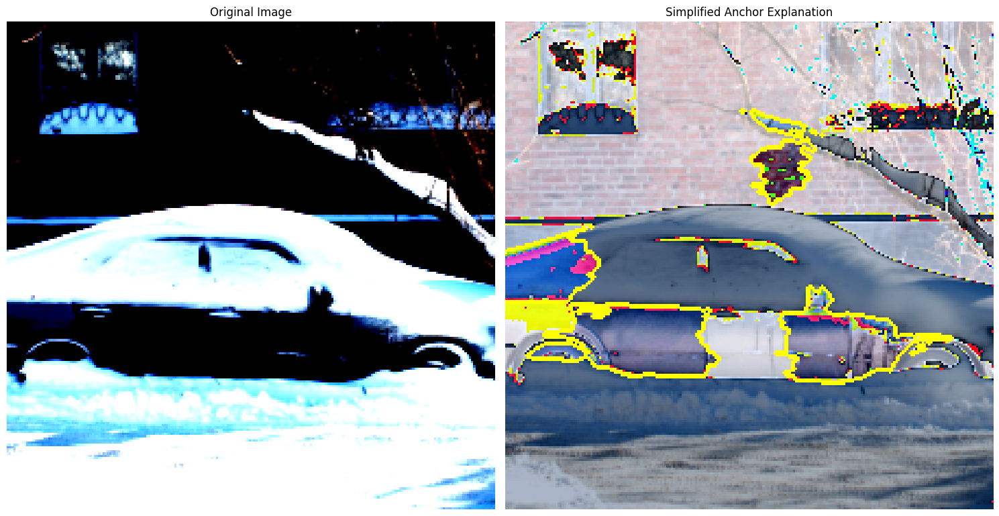


Predicted class: 895 (warplane)
Anchor precision: 0.99
Anchor coverage: 0.06


In [26]:
def visualize_simplified_anchor(image, exp, fig_size=(15, 15)):
    anchor = exp.anchor
    segments = exp.segments

    print(f"Image shape: {image.shape}")
    print(f"Segments shape: {segments.shape}")
    print(f"Anchor shape: {anchor.shape}")

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=fig_size)

    ax1.imshow(image)
    ax1.set_title('Original Image')
    ax1.axis('off')

    # Ensure segments is 2D
    if segments.ndim == 3:
        segments = segments[:,:,0]
    print(f"Processed segments shape: {segments.shape}")

    # Create a boolean mask for the anchor
    temp_img = np.zeros(segments.shape, dtype=bool)
    if anchor.ndim == 3:
        # If anchor is 3D, we assume it's a boolean mask
        temp_img = anchor[:,:,0].astype(bool)
    elif anchor.ndim == 1:
        # If anchor is 1D, we assume it's a list of segment indices
        for seg_idx in anchor:
            temp_img[segments == seg_idx] = True
    else:
        print("Unexpected anchor shape. Please check the anchor data.")

    # Simplify the visualization
    simplified_img = image.copy()
    simplified_img[~temp_img] = simplified_img[~temp_img] * 0.3  # Darken non-anchor regions

    # Ensure image is in the correct format for mark_boundaries
    if simplified_img.dtype != np.uint8:
        simplified_img = (simplified_img * 255).astype(np.uint8)

    highlighted_img = mark_boundaries(simplified_img, temp_img, color=(1, 1, 0), mode='thick')
    ax2.imshow(highlighted_img)
    ax2.set_title('Simplified Anchor Explanation')
    ax2.axis('off')

    plt.tight_layout()
    plt.show()

    # # Save the plot
    # save_path = '/content/drive/My Drive/XAI_sample/simplified_anchor_explanation.png'
    # plt.savefig(save_path)
    # print(f"Simplified anchor explanation plot saved to {save_path}")

visualize_simplified_anchor(input_image, explanation)
print_simple_anchor_explanation(explanation)

### Anchor Evaluation

The Anchor explanation for VGG16 highlights the shape of the car, including features like the iron sheet and other structural elements, as key factors influencing the prediction of "military aircraft" (Predicted class: 895). With an anchor precision of 0.99, the explanation is highly reliable, indicating that these features consistently lead to the same prediction. However, the anchor coverage of 0.06 suggests that this explanation applies to only 6% of similar instances, indicating a limited generalizability. This explanation reflects the model's tendency to associate the car's snow-covered, elongated shape with the structure of a military aircraft, underscoring its reliance on narrow, shape-based reasoning in this context.

# Conclusion: Comparative Analysis of ResNet50 and VGG16 with XAI Methods for the Car in Snow Experiment

The car in snow experiment highlights the challenges ResNet50 and VGG16 face in accurately interpreting snow-covered scenes, where object shapes and surrounding snow create visual ambiguities. ResNet50 predicted "bobsleigh," likely due to its focus on the car's snow-covered front, which resembles a bobsleigh, while VGG16 predicted "military aircraft," associating the car's elongated shape and uncovered features with the silhouette of a warplane. Both models struggled to recognize the car in its snow-obscured state, instead relying on shape-based reasoning that led to misclassification.

**XAI Method Comparison:**  
- **LIME:** LIME revealed that both models emphasized shape-based features to make predictions. For ResNet50, LIME highlighted the car's front for "bobsleigh" and shifted attention to the surrounding snow and other features for predictions like "snowplow" and "station wagon." Similarly, for VGG16, LIME focused on the car's uncovered parts and made predictions such as "snowmobile," "bobsleigh," and "tank," demonstrating confusion in the scene’s interpretation.  
- **Grad-CAM:** Grad-CAM provided limited insights for both models. For ResNet50, it focused broadly on the car and snow without significant differentiation between predictions. For VGG16, Grad-CAM highlighted different parts of the car but lacked depth in explaining the reasoning behind specific predictions like "military aircraft," reducing its overall interpretability.  
- **Anchor:** Anchor offered the most precise explanations for both models. For ResNet50, it highlighted the car, wall, and surrounding snow as contributing to the "bobsleigh" prediction, achieving high precision (0.98) but with zero generalizability (coverage: 0.00). For VGG16, Anchor emphasized the car’s shape and iron sheet-like features for the "military aircraft" prediction, with similar reliability (precision: 0.99) but limited coverage (0.06). These explanations underscored each model's reliance on specific shape-based elements rather than broader contextual reasoning.

**Key Insights:**  
This experiment highlights the reliance of both models on shape-based reasoning in snow-obscured scenes, leading to significant misclassification. Among the XAI methods, Anchor provided the most precise explanations, while LIME exposed the fragmented focus of the models, and Grad-CAM offered minimal differentiation. To improve performance in such scenarios, future models must incorporate better contextual reasoning and environmental awareness, enabling them to distinguish objects in complex, snow-covered environments more accurately.